## TP4: Recurrent neural networks

#Part II: a generative LSTM

Like the time series in Part I, language processing tasks (generation, translation, automatic correction, etc.) lend themselves to the use of recurrent networks. \
But whatever the architecture, perceptron, RNN, or transformers (we will see them later), the neural network approach requires a change in representation: we must move from a sequence of words to a sequence of input vectors.
This change in representation involves several steps. The most important steps (tokenization, embedding) are illustrated here through a folk music generation task. \


In [1]:
# This tutorial is based on MIT pedagogical materials.
# First download and import the MIT 6.S191 package:
!pip install mitdeeplearning
import mitdeeplearning as mdl


import numpy as np
import os
import time
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 10.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for mitdeeplearning: filename=mitdeeplearning-0.3.0-py3-none-any.whl size=2117304 sha256=f798f4a52f07e86ae3e5ed38af8feea525d4e8cb5c74ca5ab53f68b4b59d132f
  Stored in directory: /root/.cache/pip/wheels/9c/9f/b5/0e31f83bc60a83625e37429f923934e26802d0d68cf3ef3216
Successfully built mitdeeplearning


**II.1)** From folk songs to a pytorch loader \

The first exercise consists of building a dataset from many (c.a. 800) music scores.
These scores are transcriptions of irish popular irish songs  in [ABC](https://fr.wikipedia.org/wiki/ABC_(notation)) notation.


**Q1** Load the song list and browse some of them. How melodies are encoded ?

In [2]:
songs = mdl.lab1.load_training_data()

example_song = songs[712]
print("\nExample song: ")
print(example_song)

Found 817 songs in text

Example song: 
X:380
T:Wind that Shakes the Barley
Z: id:dc-reel-352
M:C
L:1/8
K:D Major
B|A3B AFED|B3A BcdB|A3B AFED|gfed Bcd:|!
e|f3d g3e|f3d Bcde|f3d g2fg|afed Bcde|!
f3d g3e|f3d Bcde|fafd gbge|afed Bcd|]!


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [3]:
# Convert the ABC notation to audio file and listen to it
mdl.lab1.play_song(example_song)

To build our dataset, let's first merge all the songs into one text:


In [4]:
songs_joined = "\n\n".join(songs)

Now the problem is to convert a character string into a numerical sequence that can be "learned". Typically, this change in representation involves four stages:

- [Three preprocessing steps](https://web.archive.org/web/20200131102455/https://mlexplained.com/2019/11/06/a-deep-dive-into-the-wonderful-world-of-preprocessing-in-nlp/):
  * Cleaning: the text is cleaned and formatted in a standard form.
  * Tokenization: the text is segmented in elmentary units (eg: letters, words, pieces of words, etc).
  * Numericalization: each token is mapped to a numerical id.

- An embedding step: the numerical ids are mapped onto tensors. This mapping is usually parameterized by trainable weights. Hence it is done during the learning phase.


In this lab, we oversimplify the first three steps: we consider that the musical scores are already normalized and the segmentation is done by character.
Moreover, each character is mapped to an integer via the following code:

In [5]:
vocab = sorted(set(songs_joined))
char2idx = {u:i for i, u in enumerate(vocab)}
idx2char = np.array(vocab)

**Q2** How big is the “vocabulary” used here? Could we have reduced it? Say how and for what reason.

In [6]:
print(idx2char)

['\n' ' ' '!' '"' '#' "'" '(' ')' ',' '-' '.' '/' '0' '1' '2' '3' '4' '5'
 '6' '7' '8' '9' ':' '<' '=' '>' 'A' 'B' 'C' 'D' 'E' 'F' 'G' 'H' 'I' 'J'
 'K' 'L' 'M' 'N' 'O' 'P' 'Q' 'R' 'S' 'T' 'U' 'V' 'W' 'X' 'Y' 'Z' '[' ']'
 '^' '_' 'a' 'b' 'c' 'd' 'e' 'f' 'g' 'h' 'i' 'j' 'k' 'l' 'm' 'n' 'o' 'p'
 'q' 'r' 's' 't' 'u' 'v' 'w' 'x' 'y' 'z' '|']


La taille du vocabulaire ici est de 83. La plupart des caractères utilisés le sont pour le titre, ce qui pourrait être évité.

**Q3** Complete the *vectorize_string* function which converts any subsequence of the text *songs_joined* into np.array of indices.

In [7]:
### Vectorize the songs string ###

'''TODO: Write a function to convert the all songs string to a vectorized
    (i.e., numeric) representation. Use the appropriate mapping
    above to convert from vocab characters to the corresponding indices.

  NOTE: the output of the `vectorize_string` function
  should be a np.array with `N` elements, where `N` is
  the number of characters in the input string
'''
def vectorize_string(string):
  vectorized_output = np.array([char2idx[char] for char in string])
  return vectorized_output


vectorized_songs = vectorize_string(songs_joined)
print(vectorized_songs)

[49 22 13 ... 22 82  2]


The Dataset below is defined in such a way as to be able to generate target sequences shifted one step to the right w.r.t. the input sequences:

In [8]:
from torch.utils.data import Dataset, DataLoader

class BitsOfSongs(Dataset):
    """
    PyTorch Dataset for the time series data.
    """

    def __init__(self, data, input_sequence_len):
        self.data = data
        self.input_sequence_len = input_sequence_len

    def __len__(self):
        return len(self.data) - self.input_sequence_len - 1

    def __getitem__(self, start_idx):
        # Extract an input sequence
        stop_idx = start_idx + self.input_sequence_len
        sequence = self.data[start_idx:stop_idx]
        # shift right the extraction window to get the target:
        target = self.data[start_idx + 1:stop_idx + 1]
        return {'sequence': sequence, 'target': target}

**Q4** Instantiate a dataset and a dataloader. Visualize input sequences and targets.

In [9]:
dataset = BitsOfSongs(vectorized_songs, 10)
dataloader = DataLoader(dataset, batch_size=2, shuffle=True)

In [10]:
batch = next(iter(dataloader))
x = batch['sequence']
y = batch['target']
print(x, '\n', y)

tensor([[82, 60, 62, 62, 56,  1, 57, 62, 62, 14],
        [30, 27, 30,  1, 32, 30, 30, 26, 82, 27]]) 
 tensor([[60, 62, 62, 56,  1, 57, 62, 62, 14, 82],
        [27, 30,  1, 32, 30, 30, 26, 82, 27, 26]])


**II.2)** Implementation of a LSTM



Now consider the following model:


In [11]:
import numpy as np
import torch
import torch.nn as nn

class genFolk(nn.Module):

    def __init__(self, latent_size=256, hidden_size=50, vocab_size=10,
                 batch_size = 32):
        super().__init__()
        self.embedding = nn.Embedding(vocab_size, latent_size)
        self.hidden_size = hidden_size
        self.lstm = nn.LSTM(latent_size, hidden_size, batch_first=True)
        self.tanh = nn.Tanh()
        self.linear = nn.Linear(hidden_size, vocab_size)
        self.hidden_cell = (torch.zeros(1, batch_size, hidden_size),
                       torch.zeros(1, batch_size, hidden_size))

    def forward(self,seq):
        seq = self.embedding(seq)
        lstm_out, self.hidden_cell = self.lstm(seq, self.hidden_cell)
        lstm_out = self.tanh(lstm_out)
        pred = self.linear(lstm_out)
        return pred



**Q5** What role does the *self.embedding* layer play?

Permet de vectoriser les séquences d'entrée. Chaque mot dans la séquence d'entrée est représenté par un vecteur de nombres réels de taille latent_size.

On le fait pas avant parce qu'on veut aussi entraîner la partie Embedding au cours du temps.


**Q6** Briefly describe the rest of the model. Instantiate a model, compute an output and describe each of its dimensions. Also specify the reason why the batch size is taken as an argument by the class constructor.

In [12]:
embedding_dim = 256
hidden_size = 1024
batch_size = 32


model = genFolk(latent_size=embedding_dim, hidden_size=hidden_size, vocab_size=len(vocab))

In [13]:
dataset = BitsOfSongs(vectorized_songs, 100)
dataloader = DataLoader(dataset, batch_size=batch_size)

batch = next(iter(dataloader))
x = batch['sequence']
y = batch['target']
print(x.shape, y.shape)
pred = model(x)
print(pred.shape)

torch.Size([32, 100]) torch.Size([32, 100])
torch.Size([32, 100, 83])


**II.2)** Training of the model

To measure the difference between the predicted token and the observed token, it is possible to use the same cost function as in classification:

In [14]:
loss_fn  = torch.nn.CrossEntropyLoss()

def compute_loss(y, pred):
  trpred = torch.transpose(pred, 1, 2)
  return loss_fn(trpred, y)

example_batch_loss =  compute_loss(y, pred)

print("Prediction shape: ", pred.shape, " # (batch_size, sequence_length, vocab_size)")
print("scalar_loss:      ", example_batch_loss.detach().numpy())

Prediction shape:  torch.Size([32, 100, 83])  # (batch_size, sequence_length, vocab_size)
scalar_loss:       4.411219


**Q6** Why do we need to transpose the prediction tensor to be able to use cross entropy?

La fonction de cross entropy est codée pour recevoir en entrée un tenseur de la forme (batch_size, num_classes). Or ici la deuxième dimension correspond à la taille du message, donc on doit transposer notre vecteur pour calculer l'entropie croisée, en ayant une dimension pour chaque classe prédite

**Q7** Complete the following training loop, put it on a gpu, and try to get the best loss by tuning the hyperparameters.

In [15]:
### Hyperparameter setting and optimization ###

# Optimization parameters:
num_epochs = 20  #
batch_size = 32  # Experiment between 1 and 64
num_samples = 100*batch_size # num of sequences sampled at each epoch
seq_length = 100  # Experiment between 50 and 500
learning_rate = 0.0001  # Experiment between 1e-5 and 1e-1

# Model parameters:
vocab_size = len(vocab)
embedding_dim = 256
hidden_size = 1024  # Experiment between 1 and 2048

from torch.utils.data import RandomSampler
dataset = BitsOfSongs(vectorized_songs, seq_length)
sampler = RandomSampler(dataset, replacement=True, num_samples=num_samples)
dataloader = DataLoader(dataset, batch_size=batch_size, sampler=sampler)

In [16]:
model = genFolk(latent_size=embedding_dim, hidden_size=hidden_size, vocab_size=vocab_size, batch_size=batch_size).cuda()

optimizer =  torch.optim.Adam(model.parameters(), learning_rate)

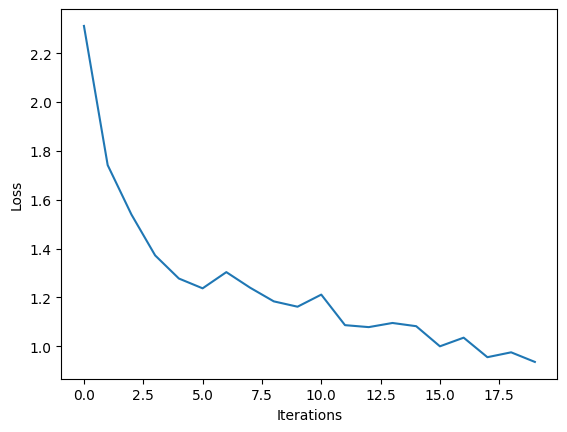

100%|██████████| 20/20 [01:21<00:00,  4.08s/it]


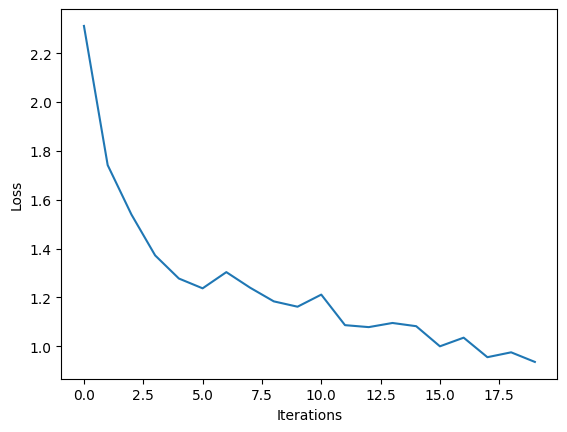

In [17]:
history = []
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='Iterations', ylabel='Loss')
if hasattr(tqdm, '_instances'): tqdm._instances.clear()

for epoch in tqdm(range(num_epochs)):
  for batch in dataloader:

    x = batch['sequence'].cuda()
    y = batch['target'].cuda()
    model.zero_grad()
    model.hidden_cell = (torch.zeros(1,batch_size,hidden_size).cuda(),
                    torch.zeros(1,batch_size,hidden_size).cuda())

    pred = model(x)

    loss = compute_loss(y, pred)
    loss.backward()
    optimizer.step()

  # Update the progress bar
  history.append(loss.detach().cpu().numpy().mean())
  plotter.plot(history)

**II.3)** Generation of folk songs

To generate a unique sequence, we will use the trained weights to instantiate a model of the same class with *batch_size*=1:

In [18]:
# To generate one sequence
batch_size_inference = 1

model_bs1 = genFolk(latent_size=256,
                hidden_size=1024,
                vocab_size=len(vocab),
                batch_size = batch_size_inference)

model_bs1.load_state_dict(model.state_dict())

model_bs1.eval()

genFolk(
  (embedding): Embedding(83, 256)
  (lstm): LSTM(256, 1024, batch_first=True)
  (tanh): Tanh()
  (linear): Linear(in_features=1024, out_features=83, bias=True)
)

Then the procedure is as follows:

- initialize $h_0$, $c_0$ to 0.
- initialize the sequence with the index $i_0$ corresponding to the letter "X", since it is with this letter that an ABC code begins.
- at each step $n$, use the model to calculate $h_n$, $c_n$ and the output $pred_n$
   from $h_{n-1}$, $c_{n-1}$ and $i_{n-1}$.
- determine $i_n$ from $pred_n$.

This last step is not done by sampling the distribution contained in $pred_n$.

These steps are coded below:

In [19]:
# nb of steps:
generation_length=1000

# init hidden & cell states
model_bs1.hidden_cell = (torch.zeros(1,1,hidden_size),
              torch.zeros(1,1,hidden_size))

# Starter:
start_string="X"
start_ids = [char2idx[s] for s in start_string]
start_ids_torch = torch.tensor(start_ids).unsqueeze(dim=0)

# init the list of successive i_n
text_generated = []

# loop for generation:
input_eval = start_ids_torch


for n in range(generation_length):
    predictions = model_bs1(input_eval)

    # Remove the batch dimension
    predictions = predictions.squeeze(dim=0)

    num_sampler = torch.distributions.categorical.Categorical(logits = predictions)
    predicted_id = num_sampler.sample()
    print(predicted_id)
    input_eval = predicted_id.unsqueeze(dim = 0)
    text_generated.append(idx2char[predicted_id.numpy()].item())

tensor([76])
tensor([67])
tensor([66])
tensor([56])
tensor([69])
tensor([0])
tensor([51])
tensor([22])
tensor([1])
tensor([64])
tensor([59])
tensor([22])
tensor([59])
tensor([58])
tensor([9])
tensor([73])
tensor([60])
tensor([60])
tensor([67])
tensor([9])
tensor([15])
tensor([21])
tensor([14])
tensor([0])
tensor([38])
tensor([22])
tensor([28])
tensor([0])
tensor([37])
tensor([22])
tensor([13])
tensor([11])
tensor([20])
tensor([0])
tensor([36])
tensor([22])
tensor([29])
tensor([1])
tensor([38])
tensor([56])
tensor([65])
tensor([70])
tensor([73])
tensor([0])
tensor([29])
tensor([82])
tensor([29])
tensor([29])
tensor([26])
tensor([8])
tensor([1])
tensor([29])
tensor([31])
tensor([26])
tensor([8])
tensor([82])
tensor([31])
tensor([29])
tensor([29])
tensor([31])
tensor([1])
tensor([32])
tensor([15])
tensor([26])
tensor([82])
tensor([32])
tensor([30])
tensor([27])
tensor([8])
tensor([1])
tensor([29])
tensor([30])
tensor([31])
tensor([82])
tensor([30])
tensor([14])
tensor([32])
tensor([31])
t

**Q8** What step does the call to *torch...Categorical* correspond to? \
Why the *logits = predictions* syntax? \
Why bother with a sampling instead of taking an *argmax* as for classification?


Le torch.Categorical correspond à l'étape de détermination de $i_n$ à partir de $pred_n$. Le Categorical renvoie des probabilités d'appartenance à chacune des classes possibles, et les logits correspondent aux données non normalisées produites par le modèle avant de rentrer dans une fonction d'activation.

Ici, le sampling apporte de la variété dans la création de la chanson. Si on avait fait un argmax, on aurait pris à chaque étape la note ayant la plus haute probabilité d'apparition, et ainsi on se serait beaucoup approché d'une chanson déjà existante.

**Q9** Comment on the appearance of the texts generated by the model.

In [20]:
text_generated = start_string + ''.join(text_generated)
print(text_generated)

Xulkan
Z: id:dc-reel-392
M:C
L:1/8
K:D Major
D|DDA, DFA,|FDDF G3A|GEB, DEF|E2GF G2B,|EDB, E,CE,C|!
A,DFA BdAF|GEGc BABG|Add AdB cAAG|EAdd AGd2:|!
edAF E2AB|cdef gfge|dede dBA^c|d2fd d2:|!

X:130
T:Hxtyt Mullimor
Z: id:dc-jig-7
M:6/8
L:1/8
K:D Mixolydian
dB|ABA GEF|D3 Add|edc d2e|d4 def|!
g2 fg fd|c2 c3 c|Bc|d2 g2|!
de fB|A3 A|GE D2|D4:|!

X:16
T:Frtke Lesterun's
Z: id:dc-setdance-22
M:C
L:1/8
K:G Major
D|G2BG d2dB|d2Bd e2ge|dBB2 B2BA|dBGB ABAG|!
G2BG AGF2|=FGAB Bdeg|f2ec f2ge|fedB AGA/B|!
B2d BEF|B3 GEB|AGE D3|G2GA Bdef|dggd dBA:|!
g|a2a2 gefg|egdB AGEG|ABGE EDED|gfgd B3e|ABAG A3|]!

X:173
T:Killias's
Z: id:dc-reel-315
M:C
L:1/8
K:G Mixolydian
DG|DGFD GFGB|G2GF GBdG|A2Bf efge|d^cde fdcA|!
BGG FGA|DGFG G3F|DECG FGFG|!
AFAF DEFA|GFGD B(DGBG|AGFE DEFG|ABA F2 A2:|!

X:147
T:JRemearty's
Z: id:dc-reel-22
M:C
L:1/8
K:D Dorian
DEFG AGBA|GAGE EGAB|cdef gfed|cAAG ABcd|!
A2Ae AdBG|Add2 AGAc|BAGB AGEG|AGED D2:|!
A|BAG E2DG|AFGA BAFG|ABd2 fdd2|edBA G2:|!
Bd|eaa2 eaba|gede egag|egga g2bg|afae gedB|A

C'est assez similaire aux textes produits précédemment.

**Q10** Use the code below to listen to melodies generated by your LSTM:

In [21]:
from IPython import display as ipythondisplay

# To extract a list of potential songs among text_generated:
generated_songs = mdl.lab1.extract_song_snippet(text_generated)

for i, song in enumerate(generated_songs):
  waveform = mdl.lab1.play_song(song)

  # if play_song worked, display the audio box:
  if waveform:
    print("Generated song", i)
    ipythondisplay.display(waveform)

Found 4 songs in text
Generated song 1


Generated song 2


Generated song 3
